In [1]:
from cryoS2Sdrop.analyze import *

PARENT_PATH = setup.PARENT_PATH

pd.options.display.float_format = "{:,.6f}".format
pd.set_option('display.max_columns', 50)

%matplotlib inline
%config Completer.use_jedi = False
%load_ext autoreload
%autoreload 2

# Gaussian + Poisson noise 

## Model 8

In [5]:
tomo_list = [
    'tomoPhantom_model8_noisyGaussPoissVL',
    'tomoPhantom_model8_noisyGaussPoissL',
    'tomoPhantom_model8_noisyGaussPoissM',
    'tomoPhantom_model8_noisyGaussPoissH'
]

exp_name = "fourierHighFreqMask_comparison"

data_log = []

for tomo in tomo_list:
    if exp_name=="":
        tomo+='_Perlin'
        
    logdir = 'data/S2SDenoising/model_logs/%s/%s/' %(tomo, exp_name)
    logdir = os.path.join(PARENT_PATH, logdir)

    _data_log = logdir_to_dataframe(logdir, clip_values=True)
    data_log.append(_data_log)

data_log = pd.concat(data_log)
data_log = data_log.reset_index().drop('index', 1)
data_log.head()

,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,fourierHighFreqMask_comparison,version_0,singleCET_FourierDataset,0,Fourier with hiFreqMask=1,{'p': '0.5'},15.389587,0.136950,7.551045,0.035820,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.397554,0.118766,7.551045,0.035820,282.327834,231.561836,103.807387,130.399296,Gauss(0.2) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,fourierHighFreqMask_comparison,version_1,singleCET_FourierDataset,0,Fourier with hiFreqMask=0.7,{'p': '0.5'},16.785675,0.131748,7.551045,0.035820,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.397554,0.118766,7.551045,0.035820,267.804668,231.561836,122.296055,130.399296,Gauss(0.2) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,fourierHighFreqMask_comparison,version_2,singleCET_FourierDataset,0,Fourier with hiFreqMask=0.5,{'p': '0.5'},17.322273,0.132066,7.551045,0.035820,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.397554,0.118766,7.551045,0.035820,268.692247,231.561836,129.402333,130.399296,Gauss(0.2) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,fourierHighFreqMask_comparison,version_0,singleCET_FourierDataset,0,Fourier with hiFreqMask=1,{'p': '0.5'},14.305648,0.116466,6.709743,0.025137,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,14.856593,0.083857,6.709743,0.025137,363.316105,233.595494,113.207105,121.418229,Gauss(0.5) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
4,fourierHighFreqMask_comparison,version_1,singleCET_FourierDataset,0,Fourier with hiFreqMask=0.7,{'p': '0.5'},15.276067,0.117544,6.709743,0.025137,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,14.856593,0.083857,6.709743,0.025137,367.606682,233.595494,127.669939,121.418229,Gauss(0.5) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


,index,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,0,fourierHighFreqMask_comparison,version_0,singleCET_FourierDataset,0,Fourier with hiFreqMask=1,{'p': '0.5'},15.389587,0.136950,7.551045,0.035820,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.397554,0.118766,7.551045,0.035820,282.327834,231.561836,103.807387,130.399296,Gauss(0.2) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,4,fourierHighFreqMask_comparison,version_1,singleCET_FourierDataset,0,Fourier with hiFreqMask=0.7,{'p': '0.5'},15.276067,0.117544,6.709743,0.025137,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,14.856593,0.083857,6.709743,0.025137,367.606682,233.595494,127.669939,121.418229,Gauss(0.5) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,6,fourierHighFreqMask_comparison,version_0,singleCET_FourierDataset,0,Fourier with hiFreqMask=1,{'p': '0.5'},13.085690,0.104736,6.378741,0.019156,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,8.315987,0.026238,6.378741,0.019156,446.760594,36.974383,105.145356,30.370349,Gauss(1.0) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,11,fourierHighFreqMask_comparison,version_2,singleCET_FourierDataset,0,Fourier with hiFreqMask=0.5,{'p': '0.5'},10.967812,0.080057,6.052643,0.010709,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,5.402924,0.009138,6.052643,0.010709,647.547188,-14.675521,81.206971,-10.734471,Gauss(5.0) + Poisson,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


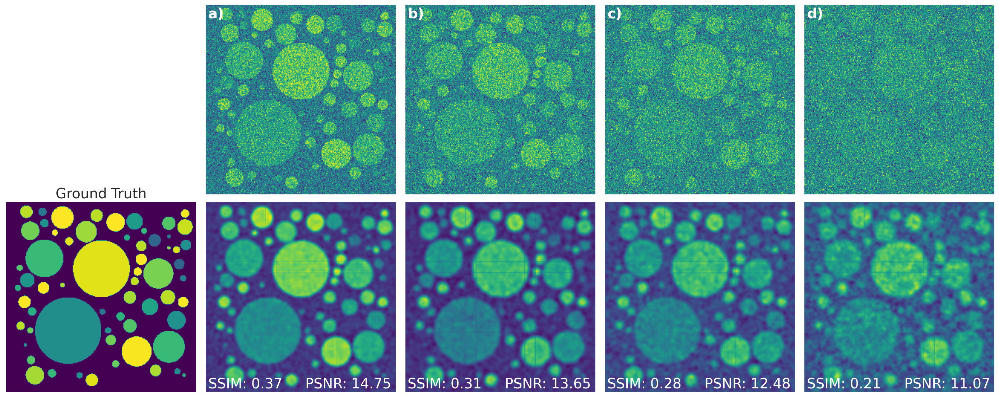

In [6]:
idx = data_log.groupby(['noise_level'])['full_tomo_ssim'].transform(max) == data_log['full_tomo_ssim']

df = data_log[idx].reset_index()

display(df)

fig, ax = plt.subplots(2, len(df)+1, figsize=(20, 8), dpi=140)
list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
plt.tight_layout()

for i, row in df.iterrows():
    gt = read_array(row.gt_tomo_path)
    gt = standardize(clip(gt))
    gt = scale(gt)
    noisy = read_array(row.tomo_path)
    noisy = standardize(clip(noisy))
    noisy = scale(noisy)
    denoised = read_array(row.pred_path)
    denoised = scale(denoised)
    
    zidx = len(gt)//2
    
    # print(row.pred_path, '\n')
    
    ax[1][0].imshow(gt[zidx], vmin=0, vmax=1)
    ax[1][0].set_title('Ground Truth', size=20)
    ax_noisy = ax[0][i+1]
    ax_denoised = ax[1][i+1]
    ax_noisy.imshow(noisy[zidx], vmin=0, vmax=1)
    ax_denoised.imshow(denoised[zidx], vmin=0, vmax=1)
    
    _ssim = ssim(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    _psnr = peak_signal_noise_ratio(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    ax_noisy.text(0.0125, 0.93, string.ascii_lowercase[i]+')', transform=ax_noisy.transAxes, size=20, weight='bold', color='white')
    ax_denoised.text(0.0125, 0.02, 'SSIM: %.02f' %float(_ssim), transform=ax_denoised.transAxes, size=20, color='white')
    ax_denoised.text(0.5+2*0.0125, 0.02, 'PSNR: %.02f' %float(_psnr), transform=ax_denoised.transAxes, size=20, color='white')

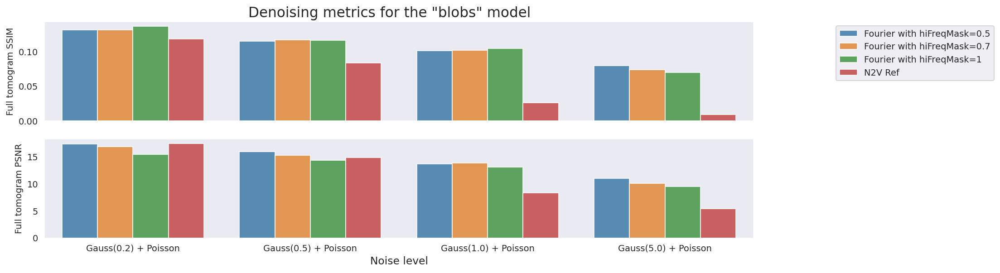

In [7]:
df = data_log.groupby(['noise_level', 'Version_comment'])['full_tomo_ssim', 'full_tomo_psnr'].mean().reset_index()

df2 = data_log.groupby(['noise_level'])['n2v_ssim', 'n2v_psnr'].mean().reset_index()
df2['Version_comment'] = 'N2V Ref'
df2 = df2[['noise_level', 'Version_comment', 'n2v_ssim', 'n2v_psnr']]
df2.columns = ['noise_level', 'Version_comment', 'full_tomo_ssim', 'full_tomo_psnr']

df = pd.concat([df, df2])

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(12, 4), sharex=True, dpi=140)

plt.tight_layout()
name = data_log.gt_tomo_path.unique()[0].split('/')[-1].replace('.mrc', '')

if name == 'tomoPhantom_model14':
    name = '"cell" model'
if name == 'tomoPhantom_model16':
    name = '"spaceship" model'
if name == 'tomoPhantom_model8':
    name = '"blobs" model'
    
plt.suptitle('Denoising metrics for the %s' %name, y=1.01)

sns.barplot(data=df, hue='Version_comment', y='full_tomo_ssim', x='noise_level', ax=ax0, alpha=0.8)
ax0.set_xlabel('')
ax0.legend(bbox_to_anchor=(1.11, 1))

sns.barplot(data=df, hue='Version_comment', y='full_tomo_psnr', x='noise_level', ax=ax1, alpha=0.8)
ax1.set_xlabel('Noise level')

ax0.set_ylabel('Full tomogram SSIM', fontsize=10)
ax1.set_ylabel('Full tomogram PSNR', fontsize=10)
ax1.get_legend().remove()

## Model 14

In [2]:
tomo_list = [
    'tomoPhantom_model14_noisyGaussPoissVL',
    'tomoPhantom_model14_noisyGaussPoissL',
    'tomoPhantom_model14_noisyGaussPoissM',
    'tomoPhantom_model14_noisyGaussPoissH'
            ]

data_log = []

for tomo in tomo_list:
    logdir = 'data/S2SDenoising/model_logs/%s/fourierBernoulli_dropoutLevel_comparison/' %tomo
    logdir = os.path.join(PARENT_PATH, logdir)

    _data_log = logdir_to_dataframe(logdir, clip_values=True)
    data_log.append(_data_log)

data_log = pd.concat(data_log)
data_log = data_log.reset_index().drop('index', 1)
data_log.head()

,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,fourierBernoulli_dropoutLevel_comparison,version_0,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},12.834087,0.071486,11.975887,0.051905,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,17.529369,0.172725,11.975887,0.051905,37.724575,232.770515,7.166067,46.372197,Gauss(0.2) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,fourierBernoulli_dropoutLevel_comparison,version_1,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},14.472326,0.094295,11.975887,0.051905,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.3,17.529369,0.172725,11.975887,0.051905,81.666837,232.770515,20.845545,46.372197,Gauss(0.2) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,fourierBernoulli_dropoutLevel_comparison,version_2,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},15.281293,0.132894,11.975887,0.051905,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.5,17.529369,0.172725,11.975887,0.051905,156.031815,232.770515,27.600507,46.372197,Gauss(0.2) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},16.170422,0.221352,11.975887,0.051905,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.529369,0.172725,11.975887,0.051905,326.454014,232.770515,35.024831,46.372197,Gauss(0.2) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
4,fourierBernoulli_dropoutLevel_comparison,version_0,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},11.792139,0.055177,11.085145,0.040619,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,11.009487,0.032916,11.085145,0.040619,35.838282,-18.965556,6.377851,-0.682516,Gauss(0.5) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


,index,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,3,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},16.170422,0.221352,11.975887,0.051905,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.529369,0.172725,11.975887,0.051905,326.454014,232.770515,35.024831,46.372197,Gauss(0.2) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,7,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},15.043050,0.163845,11.085145,0.040619,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,11.009487,0.032916,11.085145,0.040619,303.365534,-18.965556,35.704583,-0.682516,Gauss(0.5) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,11,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},13.104167,0.120031,10.609088,0.034440,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,12.812228,0.050329,10.609088,0.034440,248.521058,46.136322,23.518318,20.766538,Gauss(1.0) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,15,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},11.799117,0.082079,9.976456,0.026460,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,9.415624,0.018587,9.976456,0.026460,210.197017,-29.754543,18.269629,-5.621556,Gauss(5.0) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


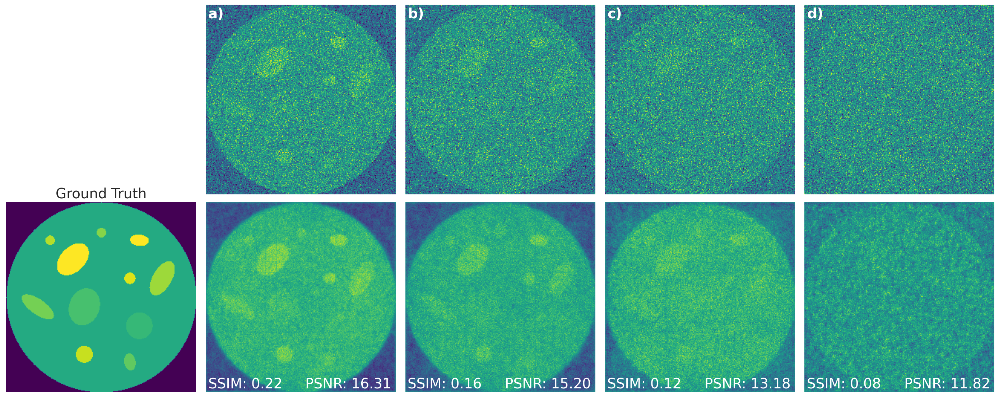

In [3]:
idx = data_log.groupby(['noise_level'])['full_tomo_ssim'].transform(max) == data_log['full_tomo_ssim']

df = data_log[idx].reset_index()

display(df)

fig, ax = plt.subplots(2, len(df)+1, figsize=(20, 8), dpi=140)
list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
plt.tight_layout()

for i, row in df.iterrows():
    gt = read_array(row.gt_tomo_path)
    gt = standardize(clip(gt))
    gt = scale(gt)
    noisy = read_array(row.tomo_path)
    noisy = standardize(clip(noisy))
    noisy = scale(noisy)
    denoised = read_array(row.pred_path)
    denoised = scale(denoised)
    
    zidx = len(gt)//2
    
    # print(row.pred_path, '\n')
    
    ax[1][0].imshow(gt[zidx], vmin=0, vmax=1)
    ax[1][0].set_title('Ground Truth', size=20)
    ax_noisy = ax[0][i+1]
    ax_denoised = ax[1][i+1]
    ax_noisy.imshow(noisy[zidx], vmin=0, vmax=1)
    ax_denoised.imshow(denoised[zidx], vmin=0, vmax=1)
    
    _ssim = ssim(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    _psnr = peak_signal_noise_ratio(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    ax_noisy.text(0.0125, 0.93, string.ascii_lowercase[i]+')', transform=ax_noisy.transAxes, size=20, weight='bold', color='white')
    ax_denoised.text(0.0125, 0.02, 'SSIM: %.02f' %float(_ssim), transform=ax_denoised.transAxes, size=20, color='white')
    ax_denoised.text(0.5+2*0.0125, 0.02, 'PSNR: %.02f' %float(_psnr), transform=ax_denoised.transAxes, size=20, color='white')

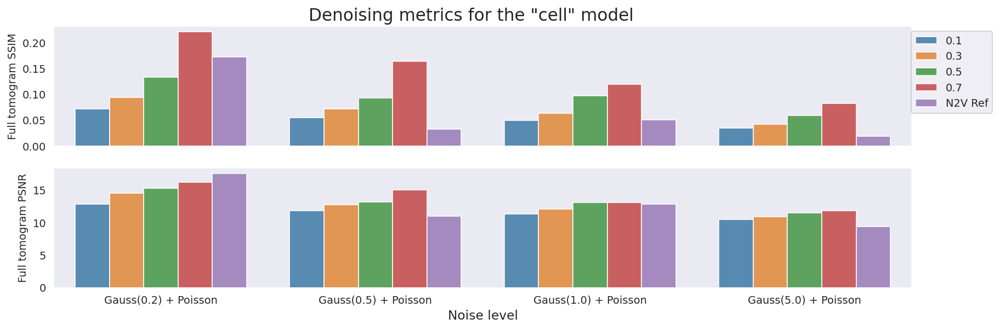

In [4]:
df = data_log.groupby(['noise_level', 'p'])['full_tomo_ssim', 'full_tomo_psnr'].mean().reset_index()

df2 = data_log.groupby(['noise_level'])['n2v_ssim', 'n2v_psnr'].mean().reset_index()
df2['p'] = 'N2V Ref'
df2 = df2[['noise_level', 'p', 'n2v_ssim', 'n2v_psnr']]
df2.columns = ['noise_level', 'p', 'full_tomo_ssim', 'full_tomo_psnr']

df = pd.concat([df, df2])

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(12, 4), sharex=True, dpi=140)

plt.tight_layout()
name = data_log.gt_tomo_path.unique()[0].split('/')[-1].replace('.mrc', '')

if name == 'tomoPhantom_model14':
    name = '"cell" model'
if name == 'tomoPhantom_model16':
    name = '"spaceship" model'
if name == 'tomoPhantom_model8':
    name = '"blobs" model'
    
plt.suptitle('Denoising metrics for the %s' %name, y=1.01)

sns.barplot(data=df, hue='p', y='full_tomo_ssim', x='noise_level', ax=ax0, alpha=0.8)
ax0.set_xlabel('')
ax0.legend(bbox_to_anchor=(1.1, 1))

sns.barplot(data=df, hue='p', y='full_tomo_psnr', x='noise_level', ax=ax1, alpha=0.8)
ax1.set_xlabel('Noise level')

ax0.set_ylabel('Full tomogram SSIM', fontsize=10)
ax1.set_ylabel('Full tomogram PSNR', fontsize=10)
ax1.get_legend().remove()

## Model 16

In [13]:
tomo_list = [
    'tomoPhantom_model16_noisyGaussPoissVL',
    'tomoPhantom_model16_noisyGaussPoissL',
    'tomoPhantom_model16_noisyGaussPoissM',
    'tomoPhantom_model16_noisyGaussPoissH'
            ]

data_log = []

for tomo in tomo_list:
    logdir = 'data/S2SDenoising/model_logs/%s/fourierBernoulli_dropoutLevel_comparison/' %tomo
    logdir = os.path.join(PARENT_PATH, logdir)

    _data_log = logdir_to_dataframe(logdir, clip_values=True)
    data_log.append(_data_log)

data_log = pd.concat(data_log)
data_log = data_log.reset_index().drop('index', 1)
data_log.head()

ValueError: too many values to unpack (expected 2)

,index,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,3,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},16.170422,0.221352,11.975887,0.051905,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,17.529369,0.172725,11.975887,0.051905,326.454014,232.770515,35.024831,46.372197,Gauss(0.2) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,7,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},15.043050,0.163845,11.085145,0.040619,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,11.009487,0.032916,11.085145,0.040619,303.365534,-18.965556,35.704583,-0.682516,Gauss(0.5) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,11,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},13.104167,0.120031,10.609088,0.034440,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,12.812228,0.050329,10.609088,0.034440,248.521058,46.136322,23.518318,20.766538,Gauss(1.0) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,15,fourierBernoulli_dropoutLevel_comparison,version_3,singleCET_FourierDataset,0,Bernoulli,{'p': '0.5'},11.799117,0.082079,9.976456,0.026460,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,9.415624,0.018587,9.976456,0.026460,210.197017,-29.754543,18.269629,-5.621556,Gauss(5.0) + Poisson,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


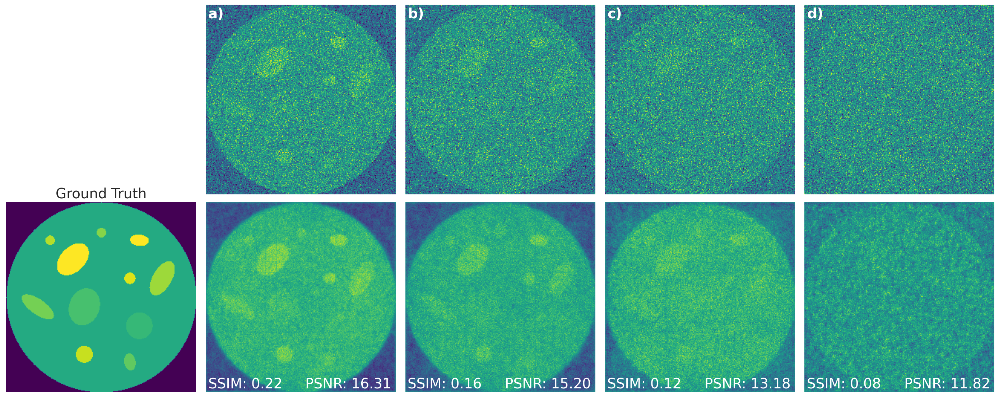

In [3]:
idx = data_log.groupby(['noise_level'])['full_tomo_ssim'].transform(max) == data_log['full_tomo_ssim']

df = data_log[idx].reset_index()

display(df)

fig, ax = plt.subplots(2, len(df)+1, figsize=(20, 8), dpi=140)
list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
plt.tight_layout()

for i, row in df.iterrows():
    gt = read_array(row.gt_tomo_path)
    gt = standardize(clip(gt))
    gt = scale(gt)
    noisy = read_array(row.tomo_path)
    noisy = standardize(clip(noisy))
    noisy = scale(noisy)
    denoised = read_array(row.pred_path)
    denoised = scale(denoised)
    
    zidx = len(gt)//2
    
    # print(row.pred_path, '\n')
    
    ax[1][0].imshow(gt[zidx], vmin=0, vmax=1)
    ax[1][0].set_title('Ground Truth', size=20)
    ax_noisy = ax[0][i+1]
    ax_denoised = ax[1][i+1]
    ax_noisy.imshow(noisy[zidx], vmin=0, vmax=1)
    ax_denoised.imshow(denoised[zidx], vmin=0, vmax=1)
    
    _ssim = ssim(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    _psnr = peak_signal_noise_ratio(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    ax_noisy.text(0.0125, 0.93, string.ascii_lowercase[i]+')', transform=ax_noisy.transAxes, size=20, weight='bold', color='white')
    ax_denoised.text(0.0125, 0.02, 'SSIM: %.02f' %float(_ssim), transform=ax_denoised.transAxes, size=20, color='white')
    ax_denoised.text(0.5+2*0.0125, 0.02, 'PSNR: %.02f' %float(_psnr), transform=ax_denoised.transAxes, size=20, color='white')

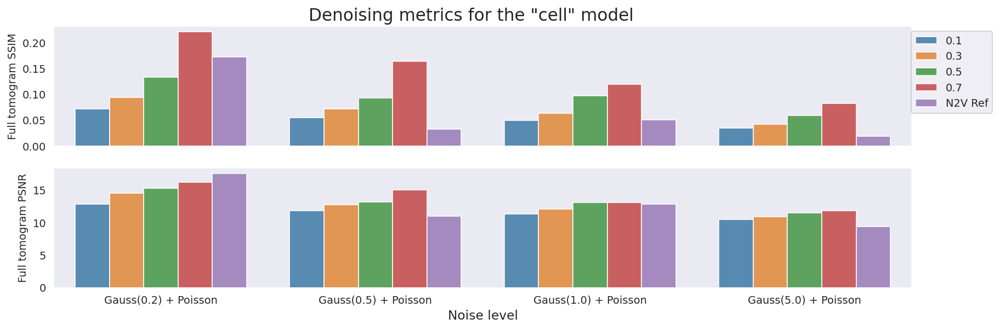

In [4]:
df = data_log.groupby(['noise_level', 'p'])['full_tomo_ssim', 'full_tomo_psnr'].mean().reset_index()

df2 = data_log.groupby(['noise_level'])['n2v_ssim', 'n2v_psnr'].mean().reset_index()
df2['p'] = 'N2V Ref'
df2 = df2[['noise_level', 'p', 'n2v_ssim', 'n2v_psnr']]
df2.columns = ['noise_level', 'p', 'full_tomo_ssim', 'full_tomo_psnr']

df = pd.concat([df, df2])

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(12, 4), sharex=True, dpi=140)

plt.tight_layout()
name = data_log.gt_tomo_path.unique()[0].split('/')[-1].replace('.mrc', '')

if name == 'tomoPhantom_model14':
    name = '"cell" model'
if name == 'tomoPhantom_model16':
    name = '"spaceship" model'
if name == 'tomoPhantom_model8':
    name = '"blobs" model'
    
plt.suptitle('Denoising metrics for the %s' %name, y=1.01)

sns.barplot(data=df, hue='p', y='full_tomo_ssim', x='noise_level', ax=ax0, alpha=0.8)
ax0.set_xlabel('')
ax0.legend(bbox_to_anchor=(1.1, 1))

sns.barplot(data=df, hue='p', y='full_tomo_psnr', x='noise_level', ax=ax1, alpha=0.8)
ax1.set_xlabel('Noise level')

ax0.set_ylabel('Full tomogram SSIM', fontsize=10)
ax1.set_ylabel('Full tomogram PSNR', fontsize=10)
ax1.get_legend().remove()

# Gaussian + Poisson + Perlin noise

## Model 8

In [22]:
tomo_list = [
    'tomoPhantom_model8_noisyGaussPoissVL',
    'tomoPhantom_model8_noisyGaussPoissL',
    'tomoPhantom_model8_noisyGaussPoissM',
    'tomoPhantom_model8_noisyGaussPoissH'
]
exp_name = "fourierBernoulliGPPnoise_dropoutLevel_comparison"

data_log = []

for tomo in tomo_list:
    if exp_name=="fourierBernoulliGPPnoise_dropoutLevel_comparison":
        tomo+='_Perlin'
        
    logdir = 'data/S2SDenoising/model_logs/%s/%s/' %(tomo, exp_name)
    logdir = os.path.join(PARENT_PATH, logdir)

    _data_log = logdir_to_dataframe(logdir, clip_values=True)
    data_log.append(_data_log)

data_log = pd.concat(data_log)
data_log = data_log.reset_index().drop('index', 1)
data_log.head()

,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,realBernoulliGPPnoise_dropoutLevel_comparison,version_0,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.403655,0.087045,7.279469,0.034949,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,None,None,7.279469,0.034949,149.064279,NaN,29.180500,NaN,Gauss(0.2) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,realBernoulliGPPnoise_dropoutLevel_comparison,version_1,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.402653,0.088804,7.279469,0.034949,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.3,None,None,7.279469,0.034949,154.097001,NaN,29.166731,NaN,Gauss(0.2) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,realBernoulliGPPnoise_dropoutLevel_comparison,version_2,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.492377,0.089404,7.279469,0.034949,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.5,None,None,7.279469,0.034949,155.814597,NaN,30.399300,NaN,Gauss(0.2) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.667597,0.087429,7.279469,0.034949,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,None,None,7.279469,0.034949,150.164532,NaN,32.806337,NaN,Gauss(0.2) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
4,realBernoulliGPPnoise_dropoutLevel_comparison,version_0,singleCET_dataset,0,Bernoulli,{'p': '0.5'},8.381665,0.067196,6.584091,0.024639,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,None,None,6.584091,0.024639,172.721164,NaN,27.301788,NaN,Gauss(0.5) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


,index,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,2,realBernoulliGPPnoise_dropoutLevel_comparison,version_2,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.492377,0.089404,7.279469,0.034949,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.5,None,None,7.279469,0.034949,155.814597,NaN,30.399300,NaN,Gauss(0.2) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,7,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},8.643347,0.068866,6.584091,0.024639,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,None,None,6.584091,0.024639,179.501207,NaN,31.276241,NaN,Gauss(0.5) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,11,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},7.835799,0.058360,6.302224,0.018864,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,None,None,6.302224,0.018864,209.367458,NaN,24.333863,NaN,Gauss(1.0) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,15,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},6.679640,0.043403,6.020516,0.010860,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,None,None,6.020516,0.010860,299.663315,NaN,10.947963,NaN,Gauss(5.0) + Poisson + Perlin,blobs,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


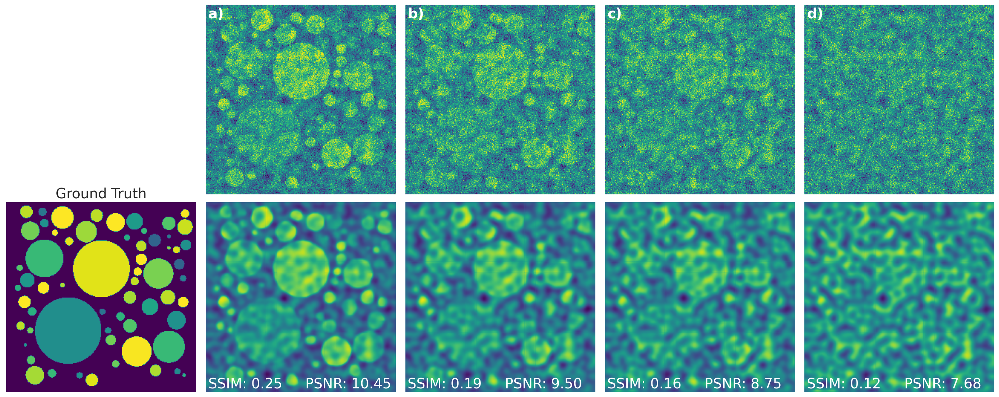

In [24]:
idx = data_log.groupby(['noise_level'])['full_tomo_ssim'].transform(max) == data_log['full_tomo_ssim']

df = data_log[idx].reset_index()

display(df)

fig, ax = plt.subplots(2, len(df)+1, figsize=(20, 8), dpi=140)
list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
plt.tight_layout()

for i, row in df.iterrows():
    gt = read_array(row.gt_tomo_path)
    gt = standardize(clip(gt))
    gt = scale(gt)
    noisy = read_array(row.tomo_path)
    noisy = standardize(clip(noisy))
    noisy = scale(noisy)
    denoised = read_array(row.pred_path)
    denoised = scale(denoised)
    
    zidx = len(gt)//2
    
    # print(row.pred_path, '\n')
    
    ax[1][0].imshow(gt[zidx], vmin=0, vmax=1)
    ax[1][0].set_title('Ground Truth', size=20)
    ax_noisy = ax[0][i+1]
    ax_denoised = ax[1][i+1]
    ax_noisy.imshow(noisy[zidx], vmin=0, vmax=1)
    ax_denoised.imshow(denoised[zidx], vmin=0, vmax=1)
    
    _ssim = ssim(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    _psnr = peak_signal_noise_ratio(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    ax_noisy.text(0.0125, 0.93, string.ascii_lowercase[i]+')', transform=ax_noisy.transAxes, size=20, weight='bold', color='white')
    ax_denoised.text(0.0125, 0.02, 'SSIM: %.02f' %float(_ssim), transform=ax_denoised.transAxes, size=20, color='white')
    ax_denoised.text(0.5+2*0.0125, 0.02, 'PSNR: %.02f' %float(_psnr), transform=ax_denoised.transAxes, size=20, color='white')

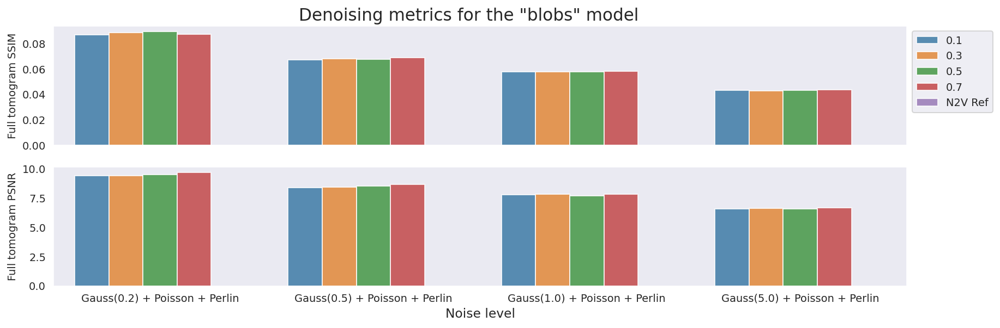

In [23]:
df = data_log.groupby(['noise_level', 'p'])['full_tomo_ssim', 'full_tomo_psnr'].mean().reset_index()

df2 = data_log.groupby(['noise_level'])['n2v_ssim', 'n2v_psnr'].mean().reset_index()
df2['p'] = 'N2V Ref'
df2 = df2[['noise_level', 'p', 'n2v_ssim', 'n2v_psnr']]
df2.columns = ['noise_level', 'p', 'full_tomo_ssim', 'full_tomo_psnr']

df = pd.concat([df, df2])

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(12, 4), sharex=True, dpi=140)
plt.tight_layout()
name = data_log.gt_tomo_path.unique()[0].split('/')[-1].replace('.mrc', '')

if name == 'tomoPhantom_model14':
    name = '"cell" model'
if name == 'tomoPhantom_model16':
    name = '"spaceship" model'
if name == 'tomoPhantom_model8':
    name = '"blobs" model'
    
plt.suptitle('Denoising metrics for the %s' %name, y=1.01)

sns.barplot(data=df, hue='p', y='full_tomo_ssim', x='noise_level', ax=ax0, alpha=0.8)
ax0.set_xlabel('')
sns.barplot(data=df, hue='p', y='full_tomo_psnr', x='noise_level', ax=ax1, alpha=0.8)
ax1.set_xlabel('Noise level')

ax0.set_ylabel('Full tomogram SSIM', fontsize=10)
ax1.set_ylabel('Full tomogram PSNR', fontsize=10)
ax0.legend(bbox_to_anchor=(1, 1))
ax1.get_legend().remove()

## Model 14

In [6]:
tomo_list = [
    'tomoPhantom_model14_noisyGaussPoissVL',
    'tomoPhantom_model14_noisyGaussPoissL',
    'tomoPhantom_model14_noisyGaussPoissM',
    'tomoPhantom_model14_noisyGaussPoissH'
]
exp_name = "fourierBernoulliGPPnoise_dropoutLevel_comparison"

data_log = []

for tomo in tomo_list:
    if exp_name=="fourierBernoulliGPPnoise_dropoutLevel_comparison":
        tomo+='_Perlin'
        
    logdir = 'data/S2SDenoising/model_logs/%s/%s/' %(tomo, exp_name)
    logdir = os.path.join(PARENT_PATH, logdir)

    _data_log = logdir_to_dataframe(logdir, clip_values=True)
    data_log.append(_data_log)

data_log = pd.concat(data_log)
data_log = data_log.reset_index().drop('index', 1)
data_log.head()

,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,realBernoulliGPPnoise_dropoutLevel_comparison,version_0,singleCET_dataset,0,Bernoulli,{'p': '0.5'},14.071221,0.354157,11.725995,0.054281,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,14.223579,0.147404,11.725995,0.054281,552.445617,171.555130,20.000233,21.299551,Gauss(0.2) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,realBernoulliGPPnoise_dropoutLevel_comparison,version_1,singleCET_dataset,0,Bernoulli,{'p': '0.5'},14.160587,0.351482,11.725995,0.054281,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.3,14.223579,0.147404,11.725995,0.054281,547.518318,171.555130,20.762351,21.299551,Gauss(0.2) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,realBernoulliGPPnoise_dropoutLevel_comparison,version_2,singleCET_dataset,0,Bernoulli,{'p': '0.5'},14.178294,0.357472,11.725995,0.054281,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.5,14.223579,0.147404,11.725995,0.054281,558.553392,171.555130,20.913356,21.299551,Gauss(0.2) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},14.259028,0.362722,11.725995,0.054281,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,14.223579,0.147404,11.725995,0.054281,568.224228,171.555130,21.601863,21.299551,Gauss(0.2) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
4,realBernoulliGPPnoise_dropoutLevel_comparison,version_0,singleCET_dataset,0,Bernoulli,{'p': '0.5'},13.051322,0.310370,10.939013,0.042982,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,12.840663,0.134019,10.939013,0.042982,622.086183,211.799626,19.309863,17.384104,Gauss(0.5) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


,index,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,3,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},14.259028,0.362722,11.725995,0.054281,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,14.223579,0.147404,11.725995,0.054281,568.224228,171.555130,21.601863,21.299551,Gauss(0.2) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,7,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},13.157752,0.321060,10.939013,0.042982,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,12.840663,0.134019,10.939013,0.042982,646.955151,211.799626,20.282803,17.384104,Gauss(0.5) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,11,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},12.461480,0.283615,10.516882,0.037008,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,11.104134,0.041208,10.516882,0.037008,666.368997,11.349870,18.490254,5.583895,Gauss(1.0) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,15,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},11.228037,0.231652,9.941481,0.029166,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,10.486538,0.066819,9.941481,0.029166,694.250197,129.099470,12.941294,5.482657,Gauss(5.0) + Poisson + Perlin,cell,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


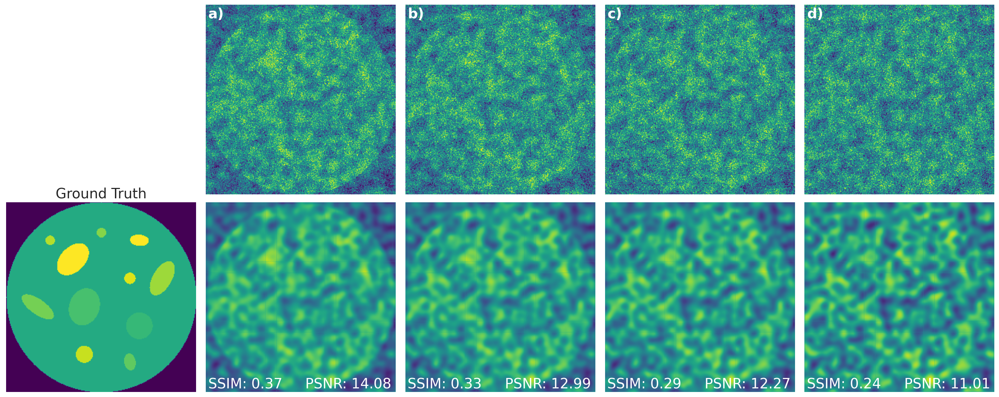

In [7]:
idx = data_log.groupby(['noise_level'])['full_tomo_ssim'].transform(max) == data_log['full_tomo_ssim']

df = data_log[idx].reset_index()

display(df)

fig, ax = plt.subplots(2, len(df)+1, figsize=(20, 8), dpi=140)
list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
plt.tight_layout()

for i, row in df.iterrows():
    gt = read_array(row.gt_tomo_path)
    gt = standardize(clip(gt))
    gt = scale(gt)
    noisy = read_array(row.tomo_path)
    noisy = standardize(clip(noisy))
    noisy = scale(noisy)
    denoised = read_array(row.pred_path)
    denoised = scale(denoised)
    
    zidx = len(gt)//2
    
    # print(row.pred_path, '\n')
    
    ax[1][0].imshow(gt[zidx], vmin=0, vmax=1)
    ax[1][0].set_title('Ground Truth', size=20)
    ax_noisy = ax[0][i+1]
    ax_denoised = ax[1][i+1]
    ax_noisy.imshow(noisy[zidx], vmin=0, vmax=1)
    ax_denoised.imshow(denoised[zidx], vmin=0, vmax=1)
    
    _ssim = ssim(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    _psnr = peak_signal_noise_ratio(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    ax_noisy.text(0.0125, 0.93, string.ascii_lowercase[i]+')', transform=ax_noisy.transAxes, size=20, weight='bold', color='white')
    ax_denoised.text(0.0125, 0.02, 'SSIM: %.02f' %float(_ssim), transform=ax_denoised.transAxes, size=20, color='white')
    ax_denoised.text(0.5+2*0.0125, 0.02, 'PSNR: %.02f' %float(_psnr), transform=ax_denoised.transAxes, size=20, color='white')

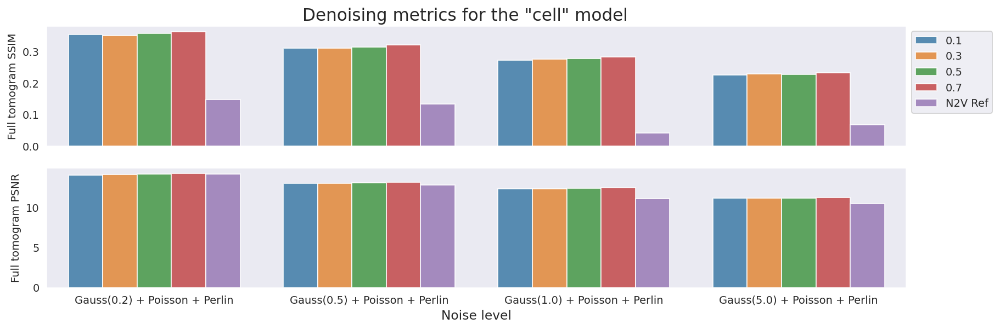

In [8]:
df = data_log.groupby(['noise_level', 'p'])['full_tomo_ssim', 'full_tomo_psnr'].mean().reset_index()

df2 = data_log.groupby(['noise_level'])['n2v_ssim', 'n2v_psnr'].mean().reset_index()
df2['p'] = 'N2V Ref'
df2 = df2[['noise_level', 'p', 'n2v_ssim', 'n2v_psnr']]
df2.columns = ['noise_level', 'p', 'full_tomo_ssim', 'full_tomo_psnr']

df = pd.concat([df, df2])

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(12, 4), sharex=True, dpi=140)
plt.tight_layout()
name = data_log.gt_tomo_path.unique()[0].split('/')[-1].replace('.mrc', '')

if name == 'tomoPhantom_model14':
    name = '"cell" model'
if name == 'tomoPhantom_model16':
    name = '"spaceship" model'
if name == 'tomoPhantom_model8':
    name = '"blobs" model'
    
plt.suptitle('Denoising metrics for the %s' %name, y=1.01)

sns.barplot(data=df, hue='p', y='full_tomo_ssim', x='noise_level', ax=ax0, alpha=0.8)
ax0.set_xlabel('')
sns.barplot(data=df, hue='p', y='full_tomo_psnr', x='noise_level', ax=ax1, alpha=0.8)
ax1.set_xlabel('Noise level')

ax0.set_ylabel('Full tomogram SSIM', fontsize=10)
ax1.set_ylabel('Full tomogram PSNR', fontsize=10)
ax0.legend(bbox_to_anchor=(1, 1))
ax1.get_legend().remove()

## Model 16

In [9]:
tomo_list = [
    'tomoPhantom_model16_noisyGaussPoissVL',
    'tomoPhantom_model16_noisyGaussPoissL',
    'tomoPhantom_model16_noisyGaussPoissM',
    'tomoPhantom_model16_noisyGaussPoissH'
]
exp_name = "fourierBernoulliGPPnoise_dropoutLevel_comparison"

data_log = []

for tomo in tomo_list:
    if exp_name=="fourierBernoulliGPPnoise_dropoutLevel_comparison":
        tomo+='_Perlin'
        
    logdir = 'data/S2SDenoising/model_logs/%s/%s/' %(tomo, exp_name)
    logdir = os.path.join(PARENT_PATH, logdir)

    _data_log = logdir_to_dataframe(logdir, clip_values=True)
    data_log.append(_data_log)

data_log = pd.concat(data_log)
data_log = data_log.reset_index().drop('index', 1)
data_log.head()

,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,realBernoulliGPPnoise_dropoutLevel_comparison,version_0,singleCET_dataset,0,Bernoulli,{'p': '0.5'},10.196292,0.283037,8.768543,0.063508,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,10.919309,0.197320,8.768543,0.063508,345.674636,210.703746,16.282621,24.528195,Gauss(0.2) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,realBernoulliGPPnoise_dropoutLevel_comparison,version_1,singleCET_dataset,0,Bernoulli,{'p': '0.5'},10.158562,0.282971,8.768543,0.063508,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.3,10.919309,0.197320,8.768543,0.063508,345.571349,210.703746,15.852331,24.528195,Gauss(0.2) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,realBernoulliGPPnoise_dropoutLevel_comparison,version_2,singleCET_dataset,0,Bernoulli,{'p': '0.5'},10.261847,0.284632,8.768543,0.063508,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.5,10.919309,0.197320,8.768543,0.063508,348.185993,210.703746,17.030232,24.528195,Gauss(0.2) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},10.274875,0.290768,8.768543,0.063508,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,10.919309,0.197320,8.768543,0.063508,357.847275,210.703746,17.178811,24.528195,Gauss(0.2) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
4,realBernoulliGPPnoise_dropoutLevel_comparison,version_0,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.250658,0.243477,7.836837,0.045643,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.1,9.925243,0.164044,7.836837,0.045643,433.435127,259.405954,18.040706,26.648583,Gauss(0.5) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


,index,model,version,dataset,TV_alpha,Version_comment,transform,full_tomo_psnr,full_tomo_ssim,baseline_psnr,baseline_ssim,tomo_path,gt_tomo_path,use_deconv_as_target,predict_simRecon,use_deconv_data,p,n2v_psnr,n2v_ssim,baseline_psnr_best,baseline_ssim_best,ssim_vs_baseline,n2v_ssim_vs_baseline,psnr_vs_baseline,n2v_psnr_vs_baseline,noise_level,tomo_name,pred_path
0,3,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},10.274875,0.290768,8.768543,0.063508,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,10.919309,0.197320,8.768543,0.063508,357.847275,210.703746,17.178811,24.528195,Gauss(0.2) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
1,7,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},9.425000,0.253873,7.836837,0.045643,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,9.925243,0.164044,7.836837,0.045643,456.211697,259.405954,20.265355,26.648583,Gauss(0.5) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
2,11,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},8.750359,0.218315,7.292865,0.036271,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,8.713853,0.108192,7.292865,0.036271,501.901797,198.288921,19.985202,19.484635,Gauss(1.0) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...
3,15,realBernoulliGPPnoise_dropoutLevel_comparison,version_3,singleCET_dataset,0,Bernoulli,{'p': '0.5'},7.473840,0.169580,6.511825,0.023784,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,/home/ubuntu/Thesis/data/S2SDenoising/dummy_to...,null,null,false,0.7,7.471733,0.072460,6.511825,0.023784,613.013782,204.666539,14.773349,14.740991,Gauss(5.0) + Poisson + Perlin,spaceship,/home/ubuntu/Thesis/data/S2SDenoising/model_lo...


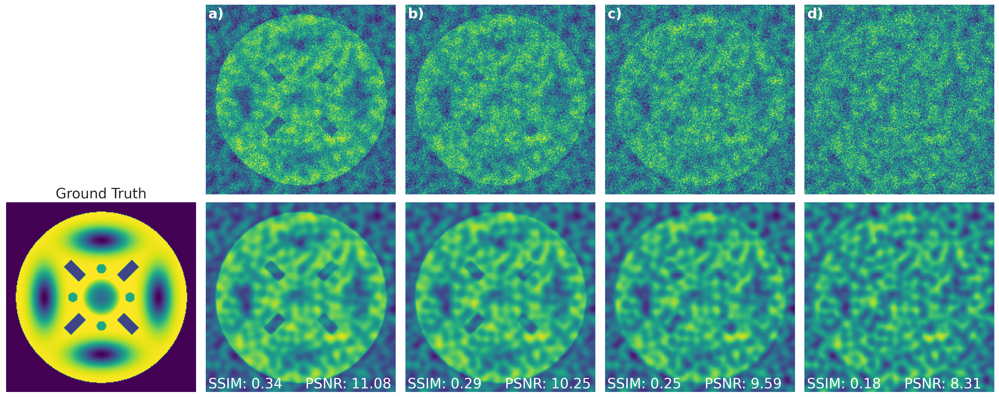

In [10]:
idx = data_log.groupby(['noise_level'])['full_tomo_ssim'].transform(max) == data_log['full_tomo_ssim']

df = data_log[idx].reset_index()

display(df)

fig, ax = plt.subplots(2, len(df)+1, figsize=(20, 8), dpi=140)
list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
plt.tight_layout()

for i, row in df.iterrows():
    gt = read_array(row.gt_tomo_path)
    gt = standardize(clip(gt))
    gt = scale(gt)
    noisy = read_array(row.tomo_path)
    noisy = standardize(clip(noisy))
    noisy = scale(noisy)
    denoised = read_array(row.pred_path)
    denoised = scale(denoised)
    
    zidx = len(gt)//2
    
    # print(row.pred_path, '\n')
    
    ax[1][0].imshow(gt[zidx], vmin=0, vmax=1)
    ax[1][0].set_title('Ground Truth', size=20)
    ax_noisy = ax[0][i+1]
    ax_denoised = ax[1][i+1]
    ax_noisy.imshow(noisy[zidx], vmin=0, vmax=1)
    ax_denoised.imshow(denoised[zidx], vmin=0, vmax=1)
    
    _ssim = ssim(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    _psnr = peak_signal_noise_ratio(torch.tensor(gt[zidx]).unsqueeze(0).unsqueeze(0),
                 torch.tensor(denoised[zidx]).unsqueeze(0).unsqueeze(0), 
                 data_range=1)
    
    ax_noisy.text(0.0125, 0.93, string.ascii_lowercase[i]+')', transform=ax_noisy.transAxes, size=20, weight='bold', color='white')
    ax_denoised.text(0.0125, 0.02, 'SSIM: %.02f' %float(_ssim), transform=ax_denoised.transAxes, size=20, color='white')
    ax_denoised.text(0.5+2*0.0125, 0.02, 'PSNR: %.02f' %float(_psnr), transform=ax_denoised.transAxes, size=20, color='white')

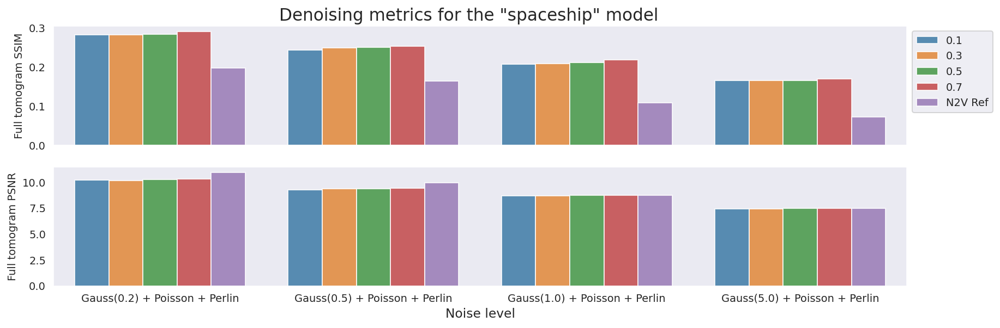

In [11]:
df = data_log.groupby(['noise_level', 'p'])['full_tomo_ssim', 'full_tomo_psnr'].mean().reset_index()

df2 = data_log.groupby(['noise_level'])['n2v_ssim', 'n2v_psnr'].mean().reset_index()
df2['p'] = 'N2V Ref'
df2 = df2[['noise_level', 'p', 'n2v_ssim', 'n2v_psnr']]
df2.columns = ['noise_level', 'p', 'full_tomo_ssim', 'full_tomo_psnr']

df = pd.concat([df, df2])

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(12, 4), sharex=True, dpi=140)
plt.tight_layout()
name = data_log.gt_tomo_path.unique()[0].split('/')[-1].replace('.mrc', '')

if name == 'tomoPhantom_model14':
    name = '"cell" model'
if name == 'tomoPhantom_model16':
    name = '"spaceship" model'
if name == 'tomoPhantom_model8':
    name = '"blobs" model'
    
plt.suptitle('Denoising metrics for the %s' %name, y=1.01)

sns.barplot(data=df, hue='p', y='full_tomo_ssim', x='noise_level', ax=ax0, alpha=0.8)
ax0.set_xlabel('')
sns.barplot(data=df, hue='p', y='full_tomo_psnr', x='noise_level', ax=ax1, alpha=0.8)
ax1.set_xlabel('Noise level')

ax0.set_ylabel('Full tomogram SSIM', fontsize=10)
ax1.set_ylabel('Full tomogram PSNR', fontsize=10)
ax0.legend(bbox_to_anchor=(1, 1))
ax1.get_legend().remove()

# Sanity Checks

I feel like the SSIM is not yielding satisfactory results that allow for comparison. The problem here is that the data is too sparse and the comparison is misleading.

**Conclusion** I re-ran tomoPhantom dataset ignoring Z slices of the tomograms with only zero values.

In [20]:
model = 'tomoPhantom_model14'

tomo0 = '%s_noisyGaussPoissVL' %model
version = 'version_0'
aux_path = 'data/S2SDenoising/model_logs/%s/realBernoulli_dropoutLevel_comparison/%s/%s_s2sDenoised.mrc'
aux_path = aux_path %(tomo0, version, tomo0)
_X0 = read_array(os.path.join(PARENT_PATH, aux_path))
_X0 = scale(_X0)
X0 = torch.tensor(_X0).unsqueeze(0)

tomo1 = '%s_noisyGaussPoissH' %model
version = 'version_2'
aux_path = 'data/S2SDenoising/model_logs/%s/realBernoulli_dropoutLevel_comparison/%s/%s_s2sDenoised.mrc'
aux_path = aux_path %(tomo1, version, tomo1)
_X1 = read_array(os.path.join(PARENT_PATH, aux_path))
_X1 = scale(_X1)
X1 = torch.tensor(_X1).unsqueeze(0)

aux_path = 'data/S2SDenoising/dummy_tomograms/%s.mrc' %model
_Y = read_array(os.path.join(PARENT_PATH, aux_path))
_Y = scale(clip(_Y))
Y = torch.tensor(_Y).unsqueeze(0)

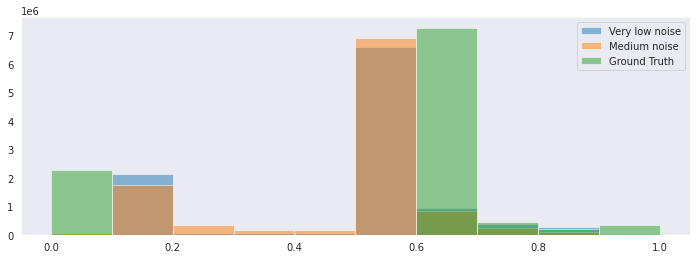

In [21]:
plt.figure(figsize=(12, 4))
plt.hist(_X0.flatten(), alpha=0.5, label='Very low noise')
plt.hist(_X1.flatten(), alpha=0.5, label='Medium noise')
plt.hist(_Y.flatten(), alpha=0.5, label='Ground Truth')
plt.legend()

In [22]:
ssim0 = float(ssim(X0, Y, data_range=1))
ssim1 = float(ssim(X1, Y, data_range=1))
ssim0, ssim1

(0.7816935181617737, 0.7196530103683472)

In [23]:
# Compare only non-zero values
mask = torch.where(Y==0, 0, 1)
aux_X0 = X0*mask
aux_X1 = X1*mask

ssim0 = float(ssim(aux_X0, Y, data_range=1))
ssim1 = float(ssim(aux_X1, Y, data_range=1))
print(ssim0, ssim1)

# _X0 = aux_X0.squeeze().numpy()
# _X1 = aux_X1.squeeze().numpy()
# X0 = aux_X0
# X1 = aux_X1

0.9381265640258789 0.8898350596427917


0


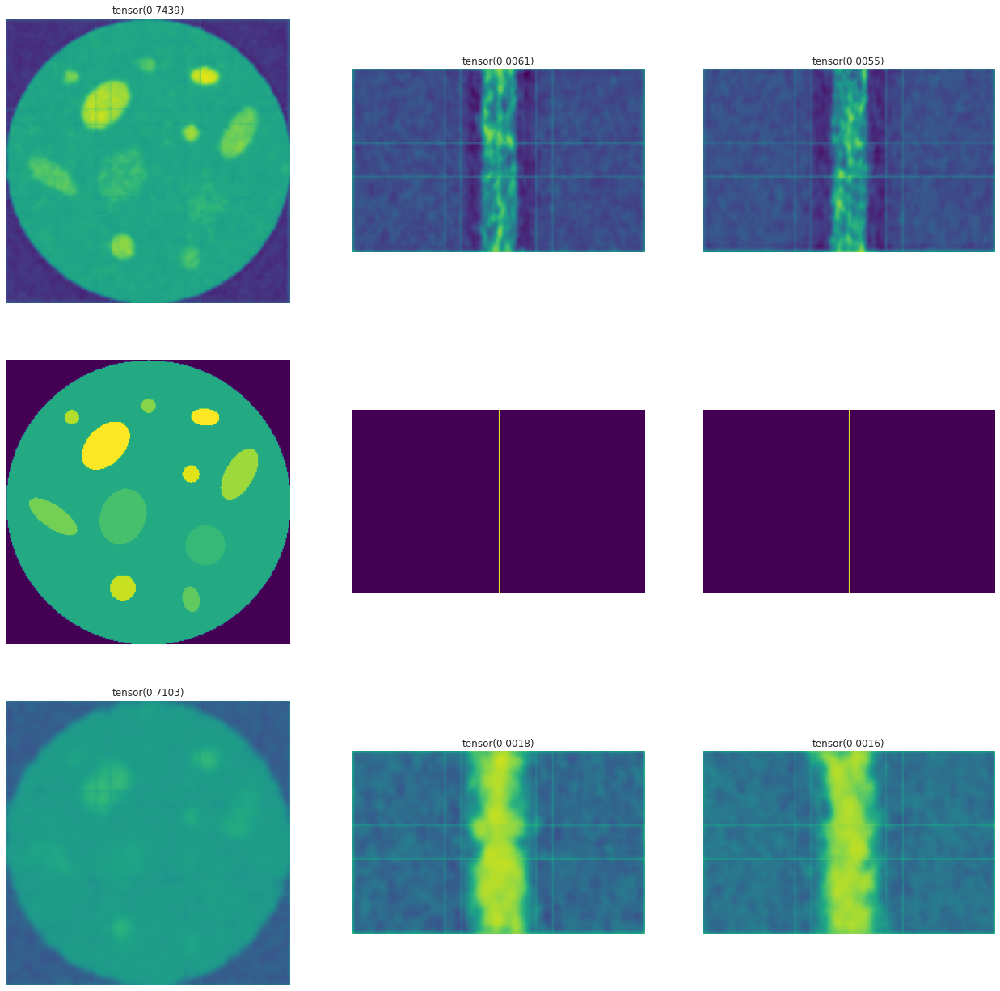

40


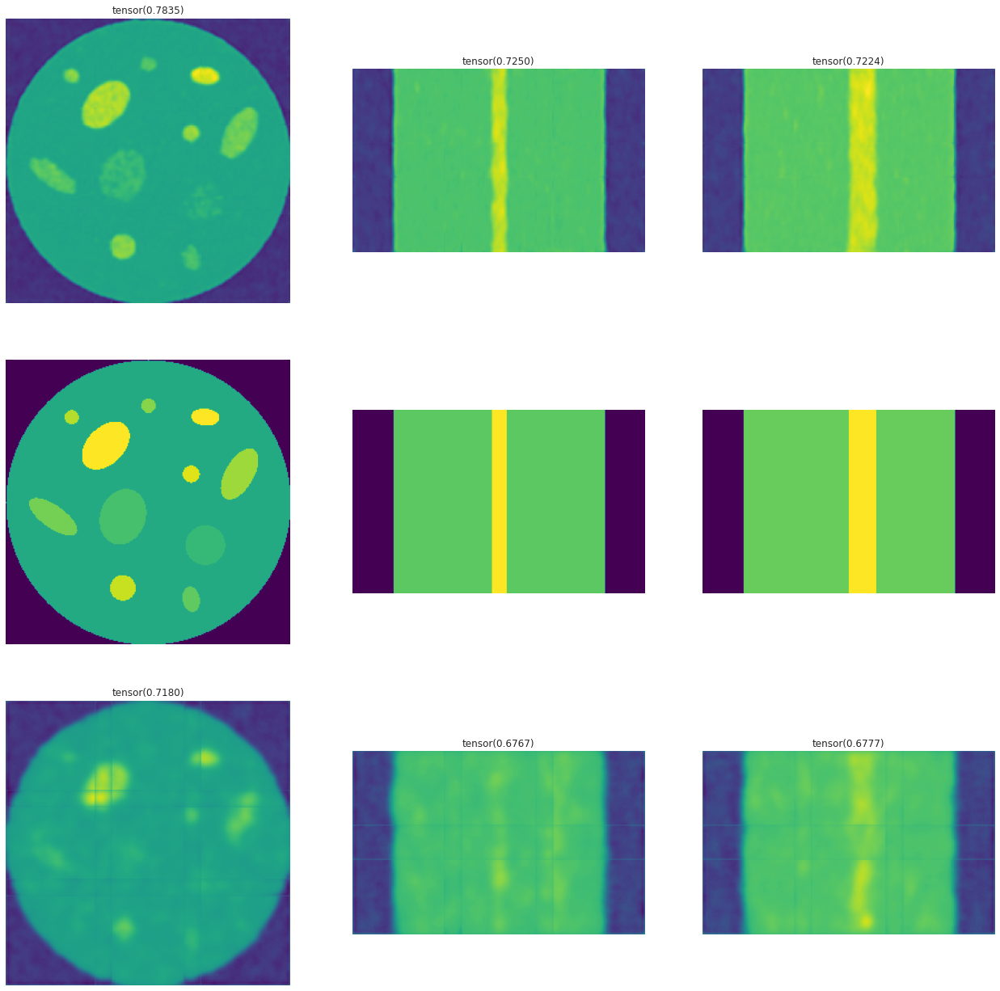

80


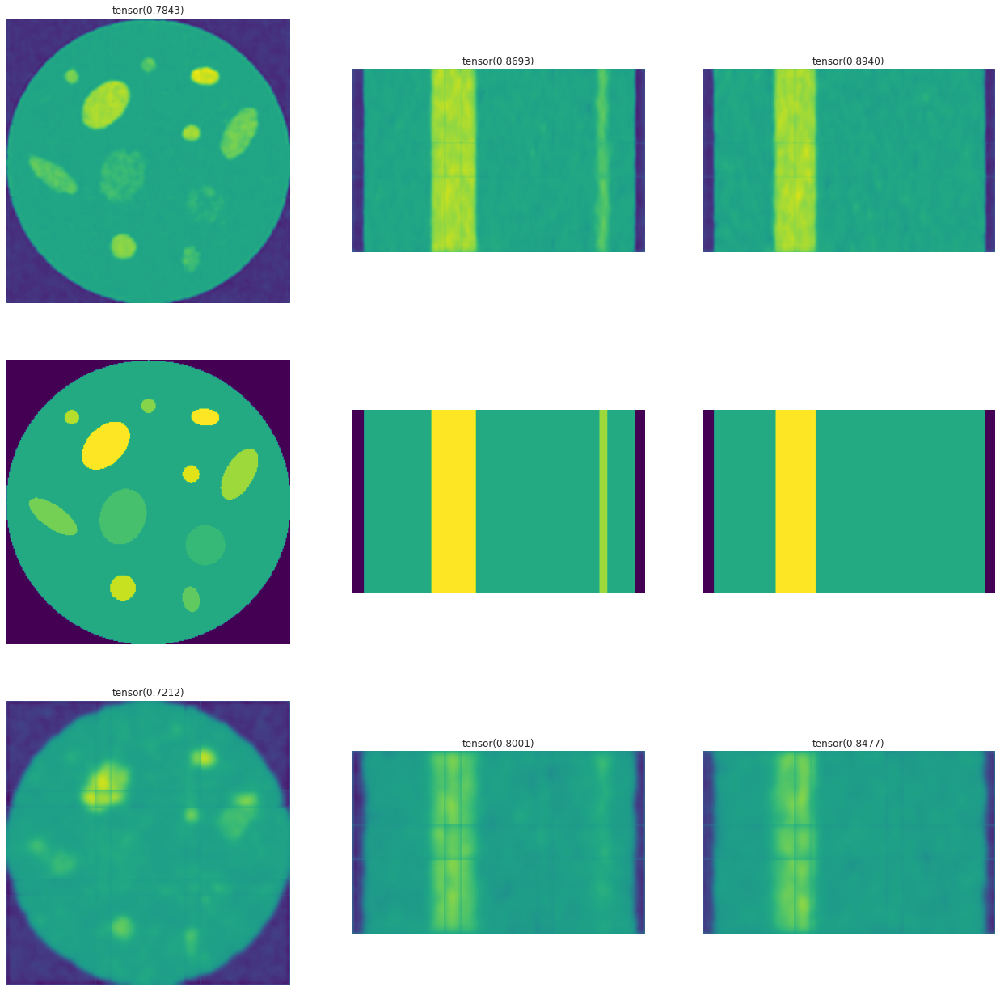

120


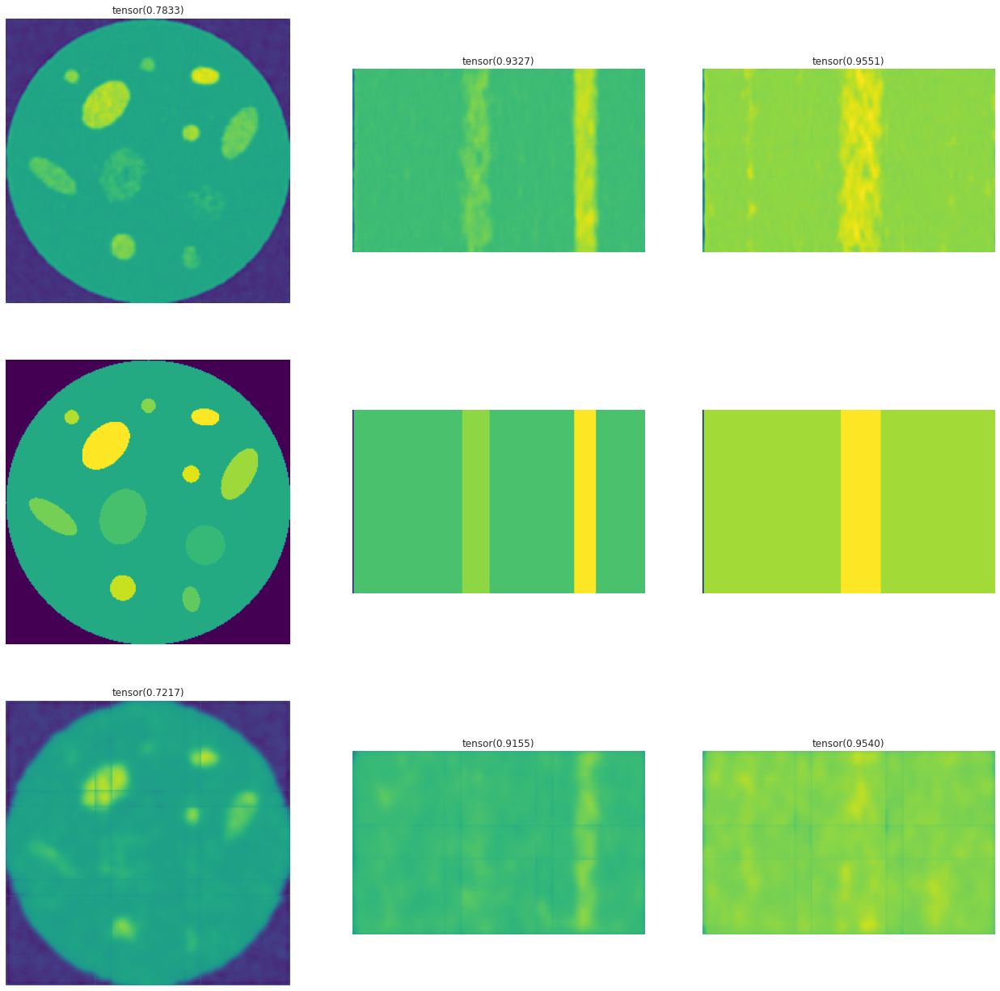

160


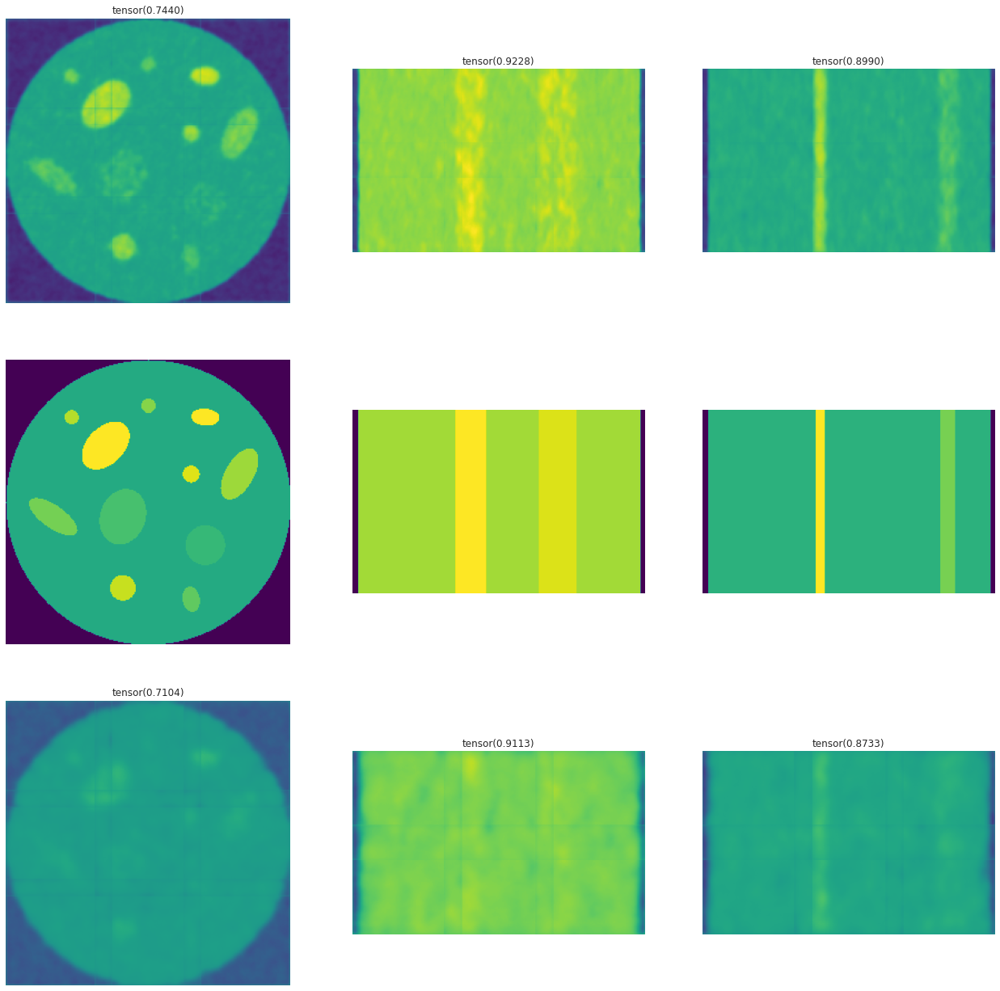

In [24]:
# zidx, yidx, xidx = np.array(_Y.shape)//2

for i in np.linspace(0, len(_Y)-1, 5, dtype=int):
    print(i)
    zidx = i
    yidx = i
    xidx = i
    
    fig, (ax0, ax1, ax2) = plt.subplots(3, 3, figsize=(22, 22))
    list(map(lambda axi: axi.set_axis_off(), np.array([ax0, ax1, ax2]).ravel()))

    ax0[0].imshow(_X0[zidx], vmin=_Y[zidx].min(), vmax=_Y[zidx].max())
    ax0[0].set_title(ssim(X0[:, zidx, :, :].unsqueeze(0).unsqueeze(0),
                          Y[:, zidx, :, :].unsqueeze(0).unsqueeze(0), data_range=1))
    ax0[1].imshow(_X0[:, yidx, :], vmin=_Y[:, yidx, :].min(), vmax=_Y[:, yidx, :].max())
    ax0[1].set_title(ssim(X0[:, :, yidx, :].unsqueeze(0).unsqueeze(0), 
                          Y[:, :, yidx, :].unsqueeze(0).unsqueeze(0), data_range=1))
    ax0[2].imshow(_X0[:, :, xidx], vmin=_Y[:, :, xidx].min(), vmax=_Y[:, :, xidx].max())
    ax0[2].set_title(ssim(X0[:, :, :, xidx].unsqueeze(0).unsqueeze(0), 
                          Y[:, :, :, xidx].unsqueeze(0).unsqueeze(0), data_range=1))


    ax1[0].imshow(_Y[zidx], vmin=_Y[zidx].min(), vmax=_Y[zidx].max())
    ax1[1].imshow(_Y[:, yidx, :], vmin=_Y[:, yidx, :].min(), vmax=_Y[:, yidx, :].max())
    ax1[2].imshow(_Y[:, :, xidx], vmin=_Y[:, :, xidx].min(), vmax=_Y[:, :, xidx].max())

    ax2[0].imshow(_X1[zidx], vmin=_Y[zidx].min(), vmax=_Y[zidx].max())
    ax2[0].set_title(ssim(X1[:, zidx, :, :].unsqueeze(0).unsqueeze(0), 
                          Y[:, zidx, :, :].unsqueeze(0).unsqueeze(0), data_range=1))
    ax2[1].imshow(_X1[:, yidx, :], vmin=_Y[:, yidx, :].min(), vmax=_Y[:, yidx, :].max())
    ax2[1].set_title(ssim(X1[:, :, yidx, :].unsqueeze(0).unsqueeze(0), 
                          Y[:, :, yidx, :].unsqueeze(0).unsqueeze(0), data_range=1))
    ax2[2].imshow(_X1[:, :, xidx], vmin=_Y[:, :, xidx].min(), vmax=_Y[:, :, xidx].max())
    ax2[2].set_title(ssim(X1[:, :, :, xidx].unsqueeze(0).unsqueeze(0), 
                          Y[:, :, :, xidx].unsqueeze(0).unsqueeze(0), data_range=1))

    plt.show()